In [ ]:
!pip install geopandas

In [13]:
import os
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, Polygon
import matplotlib.pyplot as plt

In [ ]:
# 加载地图shp文件
oklahoma_map = gpd.read_file('Igismap/UnitedStates_Boundary.shp')

# earthquake data

In [20]:
# earthquake data
inputdir = "datasets/EarthquakeData"
earthquake_df = pd.DataFrame()

for root, dirnames, filenames in os.walk(inputdir):
    for filename in filenames:
        df = pd.read_csv(os.path.join(root, filename))
        earthquake_df = earthquake_df.append(df, ignore_index=True)

In [139]:
print(earthquake_df['origintime'].min())
print(earthquake_df['origintime'].max())

2000-06-18 15:54:30
2021-05-31 18:49:54


In [153]:
earthquake_df = earthquake_df.set_index('origintime')

KeyError: "None of ['origintime'] are in the columns"

In [188]:
# 筛选某时间段地震记录
earthquake_dict = {}
month_list = ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12']
for year in range(2000, 2022):
    for month in range(0,12):
        if month == 11:
            start = str(year) + "-" + month_list[month] + "-01"
            end = str(year+1) + "-" + month_list[0] + "-01"
        else:
            start = str(year) + "-" + month_list[month] + "-01"
            end = str(year) + "-" + month_list[month+1] + "-01"
        key = start[0:7]
        value = earthquake_df.loc[start:end].shape[0]
        earthquake_dict[key] = value

In [190]:
print(earthquake_dict.keys())
print(earthquake_dict.values())

dict_keys(['2000-01', '2000-02', '2000-03', '2000-04', '2000-05', '2000-06', '2000-07', '2000-08', '2000-09', '2000-10', '2000-11', '2000-12', '2001-01', '2001-02', '2001-03', '2001-04', '2001-05', '2001-06', '2001-07', '2001-08', '2001-09', '2001-10', '2001-11', '2001-12', '2002-01', '2002-02', '2002-03', '2002-04', '2002-05', '2002-06', '2002-07', '2002-08', '2002-09', '2002-10', '2002-11', '2002-12', '2003-01', '2003-02', '2003-03', '2003-04', '2003-05', '2003-06', '2003-07', '2003-08', '2003-09', '2003-10', '2003-11', '2003-12', '2004-01', '2004-02', '2004-03', '2004-04', '2004-05', '2004-06', '2004-07', '2004-08', '2004-09', '2004-10', '2004-11', '2004-12', '2005-01', '2005-02', '2005-03', '2005-04', '2005-05', '2005-06', '2005-07', '2005-08', '2005-09', '2005-10', '2005-11', '2005-12', '2006-01', '2006-02', '2006-03', '2006-04', '2006-05', '2006-06', '2006-07', '2006-08', '2006-09', '2006-10', '2006-11', '2006-12', '2007-01', '2007-02', '2007-03', '2007-04', '2007-05', '2007-06',

In [128]:
# designate coordinate system
crs = {'init':'epsg:4326'}

# zip x and y coordinates into single feature
earthquake_geometry = [Point(xy) for xy in zip(earthquake_df['longitude'], earthquake_df['latitude'])]

# create GeoPandas dataframe
earthquake_geo_df = gpd.GeoDataFrame(earthquake_df, crs = crs, geometry = earthquake_geometry)

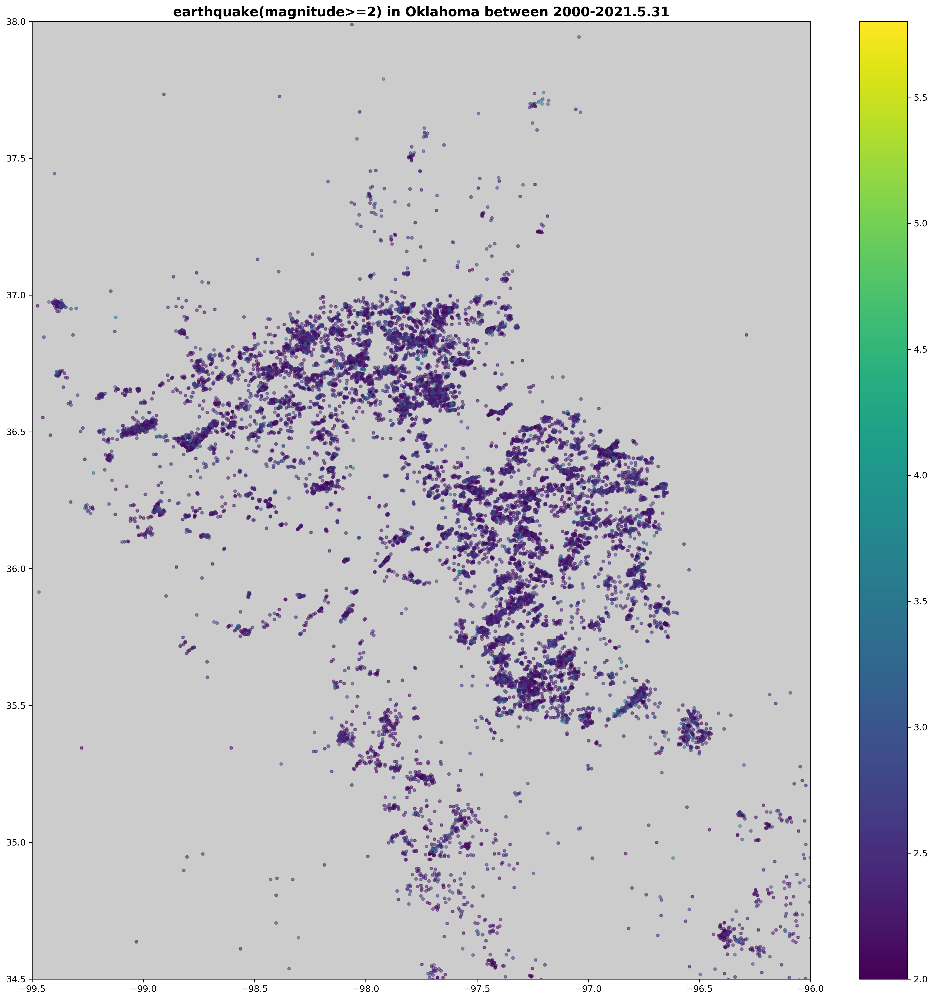

In [140]:
# earthquake 分布
# create figure and axes, assign to subplot
fig, ax = plt.subplots(figsize=(20, 20), dpi=300)
# add .shp mapfile to axes
oklahoma_map.plot(ax=ax, alpha=0.4,color='grey')
# add geodataframe to axes
# assign ‘magnitude’ variable to represent coordinates on graph
# add legend
# make datapoints transparent using alpha
# assign size of points using markersize
earthquake_geo_df.plot(column='magnitude',ax=ax, alpha=0.5, legend=True, markersize=10)
# add title to graph
plt.title('earthquake(magnitude>=2) in Oklahoma between 2000-2021.5.31', fontsize=15,fontweight='bold')
# set latitiude and longitude boundaries for map display
# plt.xlim(-103.5, -94)
# plt.ylim(33, 39)
plt.xlim(-99.5, -96)
plt.ylim(34.5, 38)
# show map
plt.show()

# Injection Data

In [109]:
# injection data
inputdir = "datasets/OCC_injection_data/MonthlyInjectionRecords"
monthly_injection_df = pd.DataFrame()

for root, dirnames, filenames in os.walk(inputdir):
    for filename in filenames:
        df = pd.read_excel(os.path.join(root, filename))
        monthly_injection_df = monthly_injection_df.append(df, ignore_index=True)

In [112]:
monthly_injection_df.head()

,API,Well_Name,Well_Number,Operator_Number,Operator_Name,Daily_Report_Date_Start,Daily_Report_Date_End,Report_Date,Volume_BPD,Pressure_PSI,Latitude,Longitude,DirArea,Directive_Status
0,3500321748,KRAFT #1-13,1,91827,SAND CREEK OPERATING LLC,2015-06-28,2020-03-29,2018-12-31,0.0,15.0,36.901215,-98.446798,OWRA,NOT IN GRANITE
1,3500321748,KRAFT #1-13,1,91827,SAND CREEK OPERATING LLC,2015-06-28,2020-03-29,2018-12-30,17.0,15.0,36.901215,-98.446798,OWRA,NOT IN GRANITE
2,3500321748,KRAFT #1-13,1,91827,SAND CREEK OPERATING LLC,2015-06-28,2020-03-29,2018-12-29,0.0,15.0,36.901215,-98.446798,OWRA,NOT IN GRANITE
3,3500321748,KRAFT #1-13,1,91827,SAND CREEK OPERATING LLC,2015-06-28,2020-03-29,2018-12-28,100.0,15.0,36.901215,-98.446798,OWRA,NOT IN GRANITE
4,3500321748,KRAFT #1-13,1,91827,SAND CREEK OPERATING LLC,2015-06-28,2020-03-29,2018-12-27,0.0,15.0,36.901215,-98.446798,OWRA,NOT IN GRANITE
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1397630,3515123808,COOK SWD,1H-12,85115,AMPLIFY OKLAHOMA OPERATING LLC,2014-10-26,2020-04-05,2014-11-05,0.0,0.0,36.740800,-98.770800,OWRA,REVIEW
1397631,3515123808,COOK SWD,1H-12,85115,AMPLIFY OKLAHOMA OPERATING LLC,2014-10-26,2020-04-05,2014-11-04,0.0,0.0,36.740800,-98.770800,OWRA,REVIEW
1397632,3515123808,COOK SWD,1H-12,85115,AMPLIFY OKLAHOMA OPERATING LLC,2014-10-26,2020-04-05,2014-11-03,0.0,0.0,36.740800,-98.770800,OWRA,REVIEW
1397633,3515123808,COOK SWD,1H-12,85115,AMPLIFY OKLAHOMA OPERATING LLC,2014-10-26,2020-04-05,2014-11-02,0.0,0.0,36.740800,-98.770800,OWRA,REVIEW


In [144]:
injection_df = monthly_injection_df[monthly_injection_df['Volume_BPD'] > 0]
# monthly_injection_df[['Well_Name','Well_Number','Volume_BPD', 'Pressure_PSI', 'Latitude', 'Longitude']]
print(injection_df[['Latitude', 'Longitude']].max())
print(injection_df[['Latitude', 'Longitude']].min())
injection_df['Report_Date'].max()
injection_df.dtypes

Latitude     36.993139
Longitude   -96.003260
dtype: float64
Latitude     34.848002
Longitude   -99.459835
dtype: float64


API                                 int64
Well_Name                          object
Well_Number                        object
Operator_Number                     int64
Operator_Name                      object
Daily_Report_Date_Start    datetime64[ns]
Daily_Report_Date_End      datetime64[ns]
Report_Date                datetime64[ns]
Volume_BPD                        float64
Pressure_PSI                      float64
Latitude                          float64
Longitude                         float64
DirArea                            object
Directive_Status                   object
dtype: object

In [119]:
# designate coordinate system
crs = {'init':'epsg:4326'}

# zip x and y coordinates into single feature
injection_geometry = [Point(xy) for xy in zip(injection_df['Longitude'], injection_df['Latitude'])]

# create GeoPandas dataframe
injection_geo_df = gpd.GeoDataFrame(injection_df, crs = crs, geometry = injection_geometry)

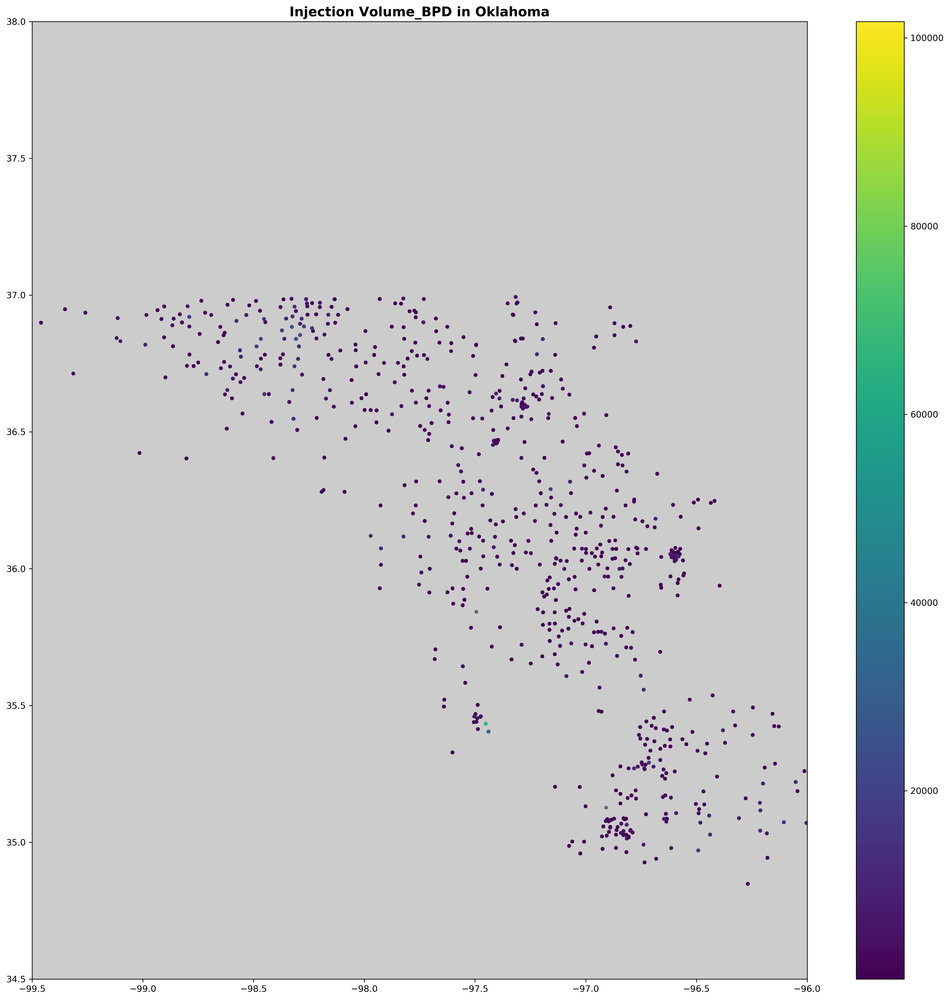

In [125]:
# Injection 分布
# create figure and axes, assign to subplot
fig, ax = plt.subplots(figsize=(20, 20), dpi=300)
# add .shp mapfile to axes
oklahoma_map.plot(ax=ax, alpha=0.4,color='grey')
# add geodataframe to axes
# assign ‘Volume_BPD’ variable to represent coordinates on graph
# add legend
# make datapoints transparent using alpha
# assign size of points using markersize
injection_geo_df.plot(column='Volume_BPD',ax=ax, alpha=0.5, legend=True, markersize=10)
# add title to graph
plt.title('Injection(Volume_BPD) in Oklahoma', fontsize=15,fontweight='bold')
# set latitiude and longitude boundaries for map display
# plt.xlim(-103.5, -94)
# plt.ylim(33, 39)
plt.xlim(-99.5, -96)
plt.ylim(34.5, 38)
# show map
plt.show()

# Well data

In [25]:
# well data
inputdir = "datasets/WellData/"
well_df = pd.read_csv(inputdir + "Export - Excel Well Workbook_Header.csv")

In [27]:
well_df.columns

Index(['UWI', 'Source', 'API Number', 'IC Number', 'Regulatory API',
       'Operator Name', 'Operator City', 'Current Operator Name',
       'Current Operator City', 'Lease Name', 'Alternate Well Name',
       'Well Num', 'Field Name', 'Country Name', 'State Name', 'County Name',
       'OS Indicator', 'Hole Direction', 'Final Status', 'Current Status',
       'Regulatory Status', 'Regulatory Status Date', 'Basin', 'Basin Code',
       'Sub Basin', 'Sub Basin Code', 'Play Name', 'Play Type',
       'Permit Number', 'Permit Date', 'Permit Status', 'Permit Reissue Date',
       'Lease Acres', 'Unit of Measure', 'Depth Total Driller',
       'Depth Total Logger', 'Depth True Vertical', 'Depth Whipstock',
       'Class Initial Name', 'Class Initial Code', 'Class Final Name',
       'Class Final Code', 'Status Final Code', 'Formation Projected Name',
       'Depth Total Projected', 'Formation at TD Name',
       'PRODFit Formation at TD Name', 'Formation Producing Name',
       'PRODFit To

In [48]:
print(well_df[['Surface Latitude', 'Surface Longitude']].max())
print(well_df[['Surface Latitude', 'Surface Longitude']].min())

Surface Latitude     37.999929
Surface Longitude   -96.000005
dtype: float64
Surface Latitude     35.000023
Surface Longitude   -99.499960
dtype: float64


In [92]:
# designate coordinate system
crs = {'init':'epsg:4326'}

# zip x and y coordinates into single feature
geometry = [Point(xy) for xy in zip(well_df['Surface Longitude'], well_df['Surface Latitude'])]

# create GeoPandas dataframe
geo_df = gpd.GeoDataFrame(well_df, crs = crs, geometry = geometry)

In [93]:
geo_df.head()

,UWI,Source,API Number,IC Number,Regulatory API,Operator Name,Operator City,Current Operator Name,Current Operator City,Lease Name,...,Proposed BH Latitude,Proposed BH Longitude,Proposed BH LL Source,BH Latitude,BH Longitude,BH LL Source,Activity Code,Permit Filer Long,Permit Phone,geometry
0,3.508320e+13,PI,3.508320e+13,NaN,3.508321e+09,MOORE REX R JR,NaN,MOORE REX R JR,NaN,WYATT `A`UNIT,...,NaN,NaN,NaN,NaN,NaN,NaN,E,NaN,NaN,POINT (-97.28016 35.78839)
1,3.508320e+13,PI,3.508320e+13,NaN,3.508321e+09,HADSON OHIO OIL CO,NaN,HADSON OHIO OIL CO,NaN,KIRKPATRICK,...,NaN,NaN,NaN,NaN,NaN,NaN,E,NaN,NaN,POINT (-97.49140 35.75801)
2,3.508320e+13,PI,3.508320e+13,NaN,NaN,LOBAR OIL CO INC,NaN,LOBAR OIL CO INC,NaN,DENNY,...,NaN,NaN,NaN,NaN,NaN,NaN,D,NaN,NaN,POINT (-97.65847 36.05349)
3,3.508320e+13,PI,3.508320e+13,NaN,NaN,BLAIK OIL CO,NaN,BLAIK OIL CO,NaN,WALL,...,NaN,NaN,NaN,NaN,NaN,NaN,D,NaN,NaN,POINT (-97.58463 36.14220)
4,3.508320e+13,PI,3.508320e+13,NaN,3.508321e+09,MOORE REX R JR,NaN,MOORE REX R JR,NaN,WYATT UNIT,...,NaN,NaN,NaN,NaN,NaN,NaN,E,NaN,NaN,POINT (-97.28454 35.78855)


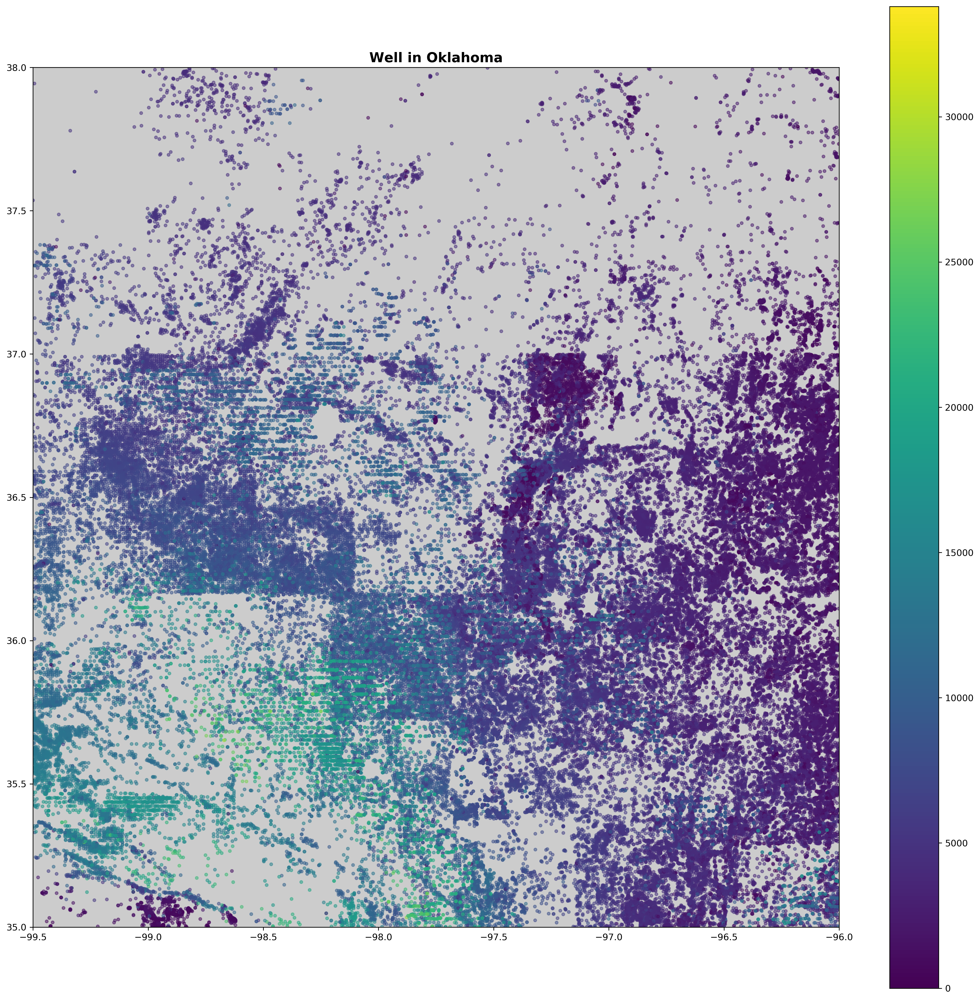

In [96]:
# well 分布
# create figure and axes, assign to subplot
fig, ax = plt.subplots(figsize=(20, 20), dpi=300)
# add .shp mapfile to axes
oklahoma_map.plot(ax=ax, alpha=0.4,color='grey')
# add geodataframe to axes
# assign ‘Depth Total Projected’ variable to represent coordinates on graph
# add legend
# make datapoints transparent using alpha
# assign size of points using markersize
geo_df.plot(column='Depth Total Projected',ax=ax, alpha=0.5, legend=True, markersize=10)
# add title to graph
plt.title('Well in Oklahoma', fontsize=15,fontweight='bold')
# set latitiude and longitude boundaries for map display
# plt.xlim(-103.5, -94)
# plt.ylim(33, 39)
plt.xlim(-99.5, -96)
plt.ylim(35, 38)
# show map
plt.show()